In [1]:
import scanpy as sc

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.style as style
import matplotlib

import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

# utils function -- helper functions for plotting
import sys
sys.path.append('../../utils/')
import figure_utils as figure_utils

In [2]:
%matplotlib inline
matplotlib.rcParams['figure.dpi'] = 500 # 150 dpi resolution
matplotlib.rcParams['image.cmap'] = 'Spectral_r' # preferred color map
# matplotlib.rcParams['figure.figsize'] = [6, 6] # Square
# no bounding boxes or axis:
matplotlib.rcParams['axes.spines.bottom'] = "off"
matplotlib.rcParams['axes.spines.top'] = "off"
matplotlib.rcParams['axes.spines.left'] = "off"
matplotlib.rcParams['axes.spines.right'] = "off"

In [3]:
# UMAP PARAMS
DOT_SIZE = 25
LEGEND_FONTSIZE = 8
LEGEND_FONTOUTLINE = 1
UMAP_FIGSIZE = (10,10)

# SEXES COLOR
# HERM_COLOR = '#f58020'
# MALE_COLOR = '#1479b8'
# SHARED_SEX_COLOR = '#c2b69b'

# SEXES COLOR -- NEW
HERM_COLOR = '#ff8b00'
MALE_COLOR = '#2258a5'
SHARED_SEX_COLOR = '#349c55'

# SHEATH/SOCKET COLORS
# SHEATH_COLOR = '#a5444b'
# SOCKET_COLOR = '#bfbaba'

# DEAFULT teal brown
# SHEATH_COLOR = '#008080'
# SOCKET_COLOR = '#8B4513'

# lighter teal -- EQ
SHEATH_COLOR = '#3ac9c9' # '#369e9e'
SOCKET_COLOR = '#c47841'

# teal magenta

# lighter teal brown
# SHEATH_COLOR = '#00CED1'
# SOCKET_COLOR = '#D2691E'

# HEATMAP COLOR AESTHETICS
PLOTLY_COLOR_TEMPLATE = 'plotly_white'
HEATMAP_COLOR = [[0,'rgb(250,250,250)'], [1,'rgb(102,0,204)']]
HEATMAP_MIN_COLOR = 0
HEATMAP_MAX_COLOR = 4

In [4]:
adata = sc.read('../../data/WholeData.h5ad')
adata_glia = sc.read('../../data/GliaOnly.h5ad')

# SFig 6A -- <i>mdl-1 & cey-4</i> Expression in Hermaphrodites

In [5]:
# keep this outsie the function -- perform the test in the shared cluster
glia_shared = adata_glia[adata_glia.obs['sex_specificity'] == 'Both',:].copy()

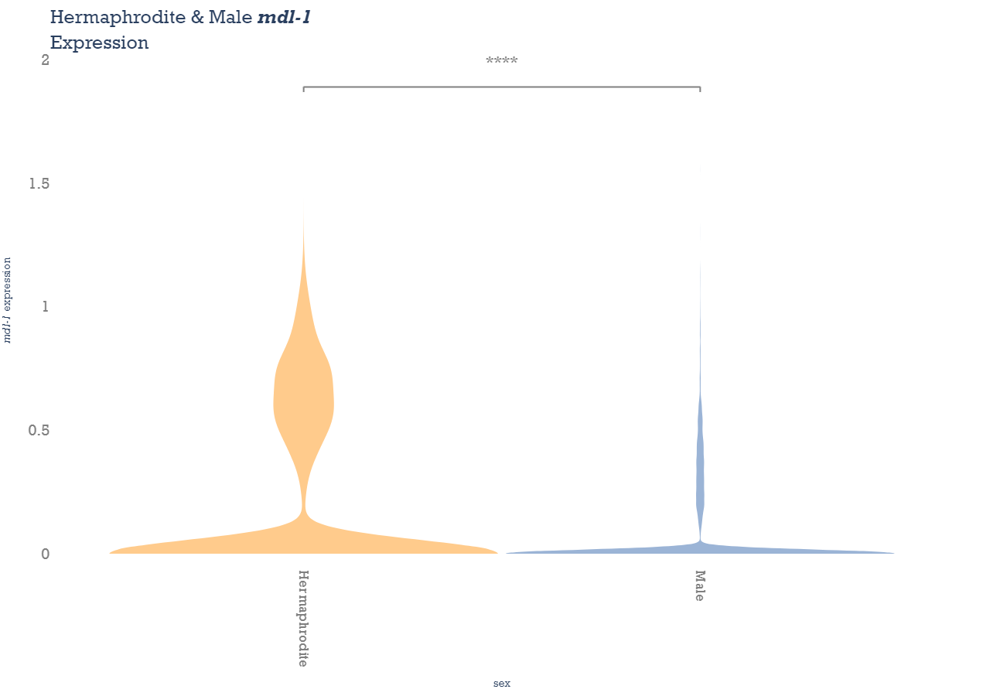

In [6]:
figure_utils.sexes_gene_expression_comparison(ad_data=adata_glia, gene_name='mdl-1', 
                                 herm_color=HERM_COLOR, male_color=MALE_COLOR, filename='figures/ttest_expr_S6A_mdl-1')

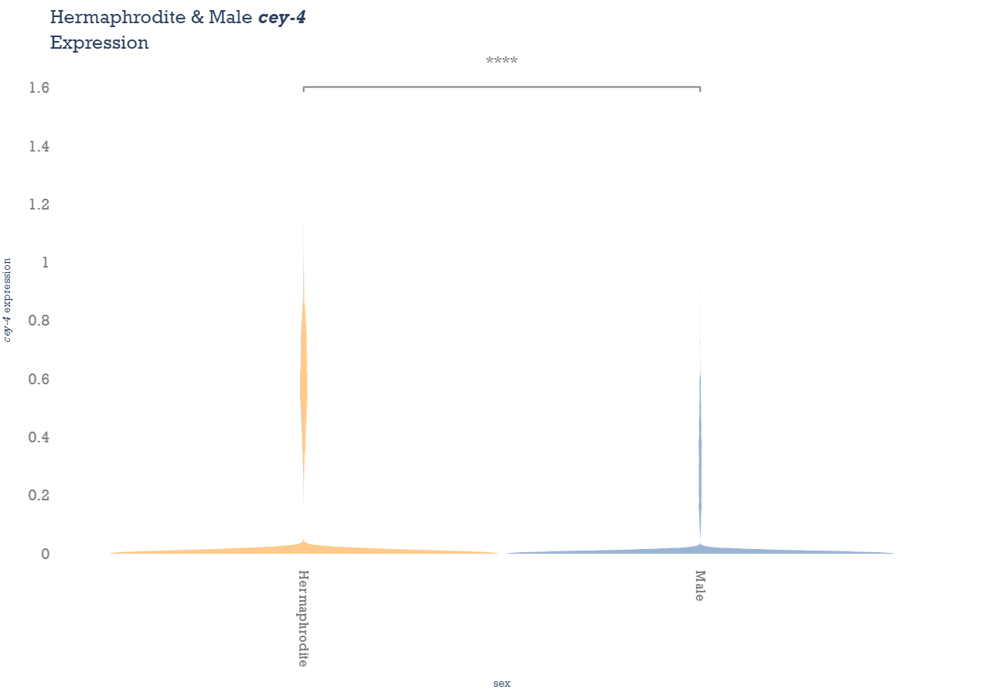

In [7]:
figure_utils.sexes_gene_expression_comparison(ad_data=adata_glia, gene_name='cey-4', 
                                 herm_color=HERM_COLOR, male_color=MALE_COLOR, filename='figures/ttest_expr_S6A_cey-4')

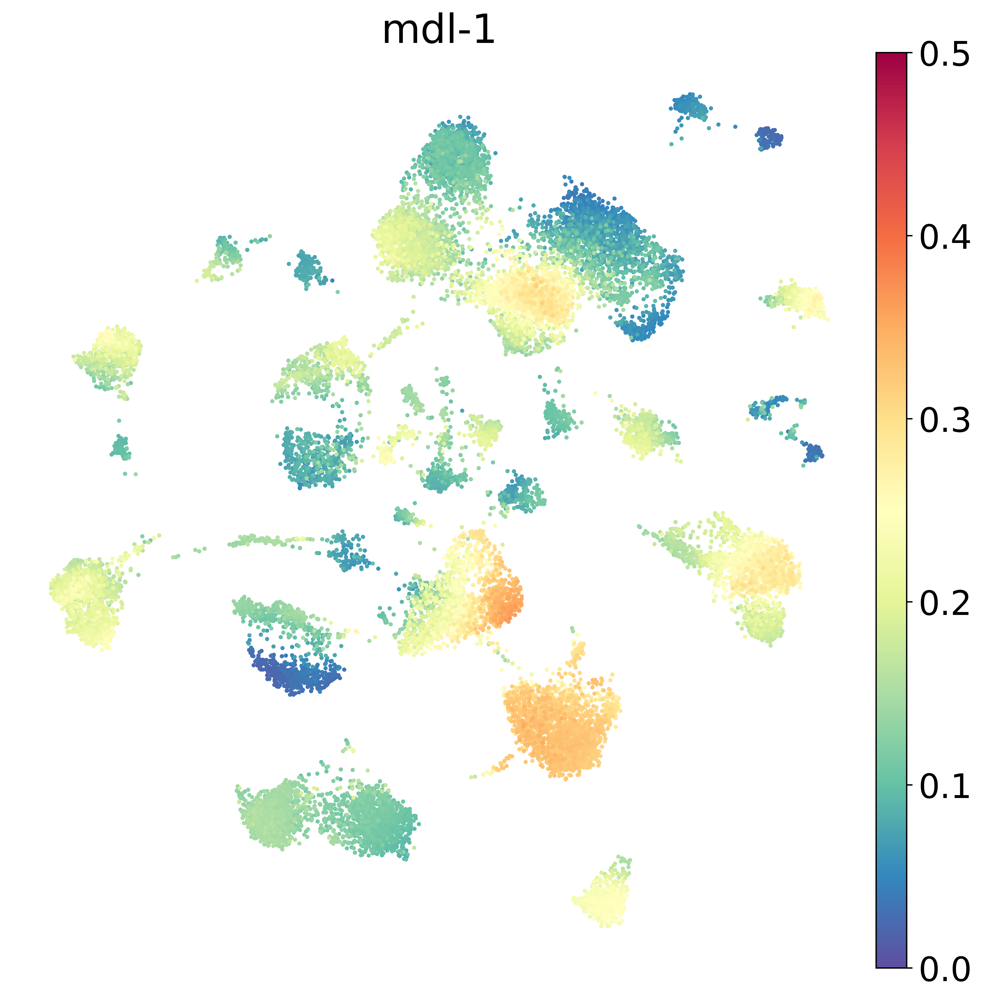

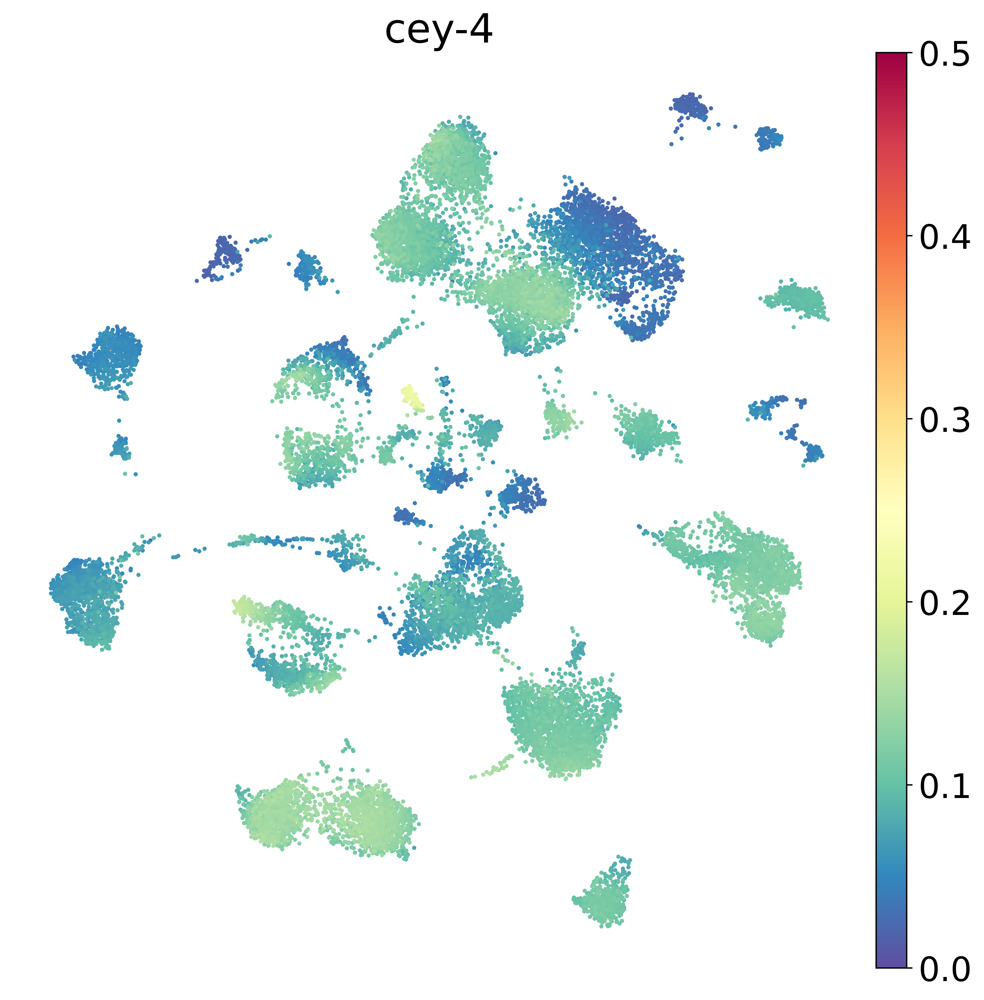

In [8]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['mdl-1','cey-4'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
#             groups=['Hermaphrodite'],
            legend_loc=None,
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S6A_{gene}.png',
            layer='magic_imputed_postBC',
            vmin=0.0,
            vmax=0.5
        )

# SFig 6B -- <i>mab-3</i> Expression in Males

In [9]:
# keep this outsie the function -- perform the test in the shared cluster
glia_shared = adata_glia[adata_glia.obs['sex_specificity'] == 'Both',:].copy()

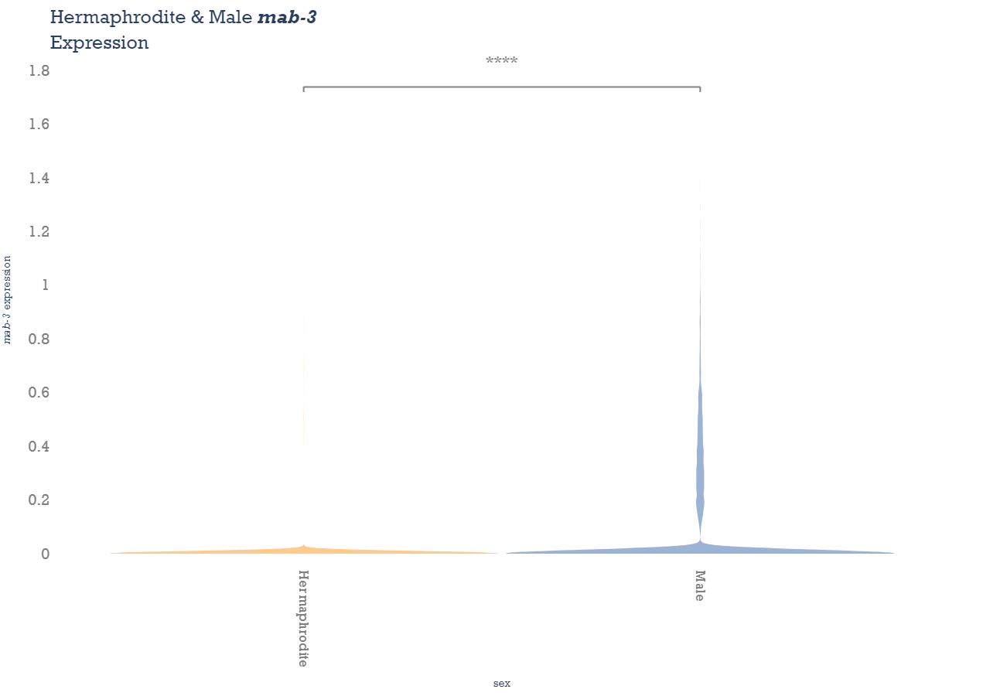

In [10]:
figure_utils.sexes_gene_expression_comparison(ad_data=adata_glia, gene_name='mab-3', 
                                 herm_color=HERM_COLOR, male_color=MALE_COLOR, filename='figures/ttest_expr_S6B_mab-3')

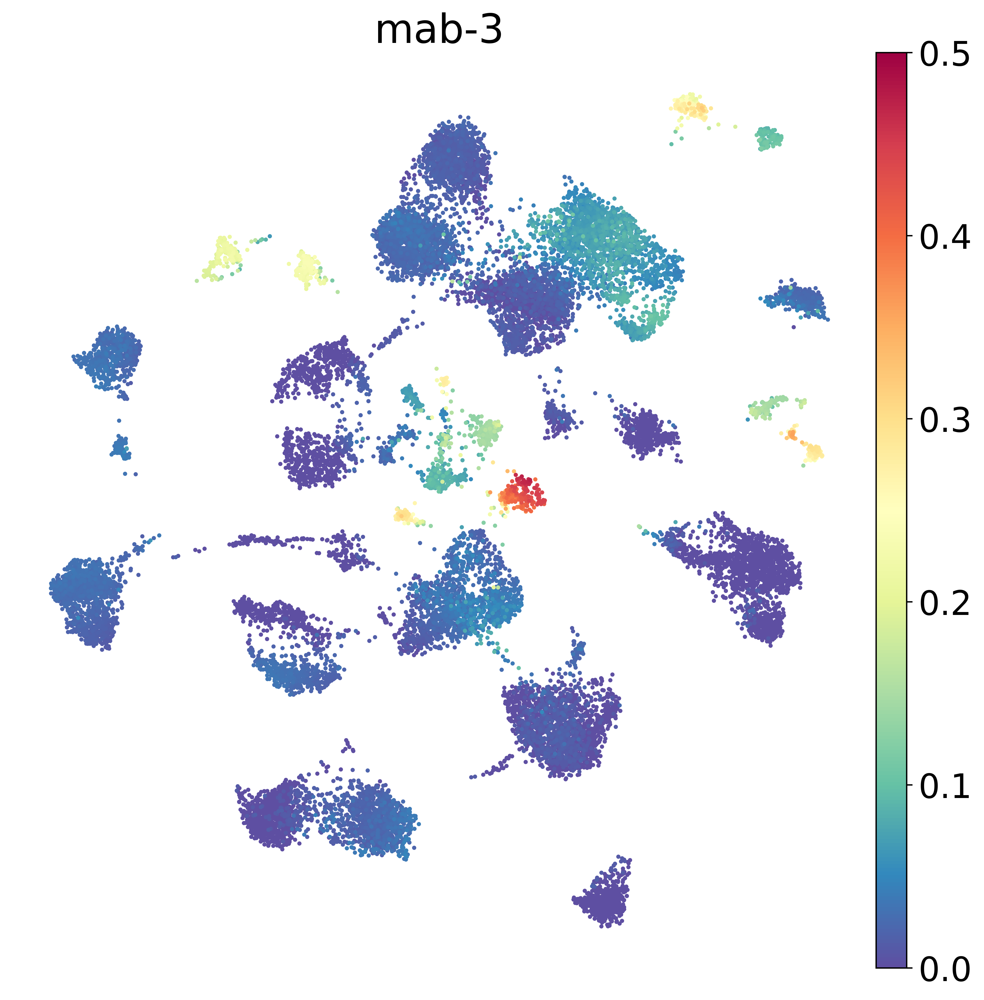

In [11]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['mab-3'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
#             groups=['Male'],
            legend_loc=None,
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S6B_{gene}.png',
            layer='magic_imputed_postBC',
            vmin=0.0,
            vmax=0.5
        )

# SFig 6C -- <i>T27D12.1</i> Expression

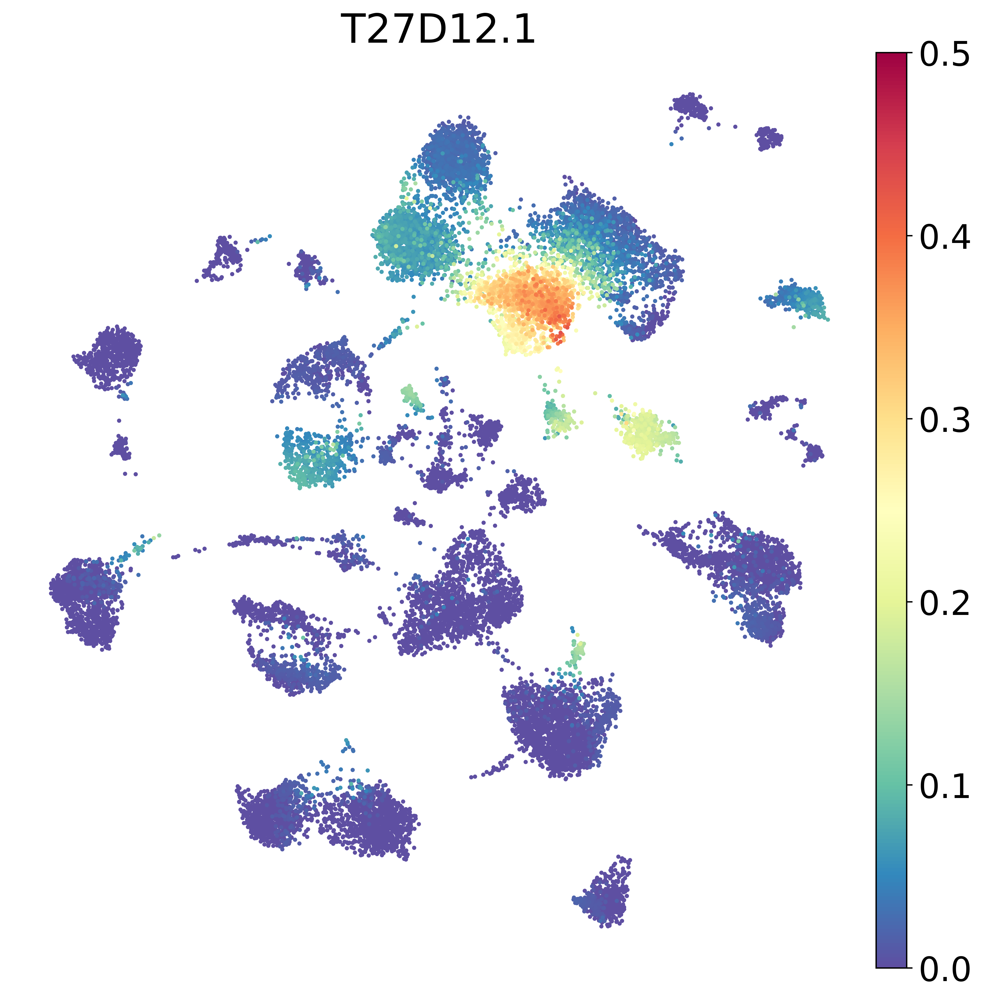

In [12]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['T27D12.1'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S6C_{gene}.png',
            layer='magic_imputed_postBC',
            vmin=0.0,
            vmax=0.5
        )

# SFig 6D -- Pairwise Cluster 0

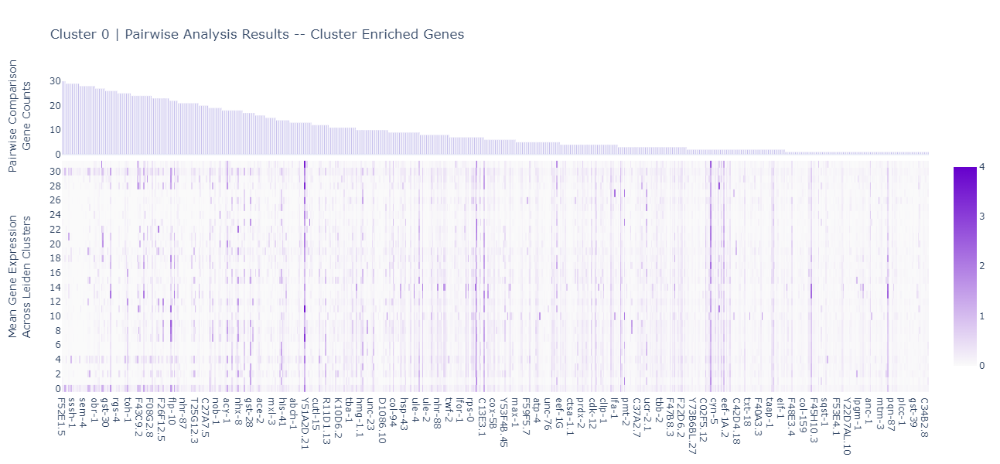

In [13]:
figure_utils.get_pairwise_results(adata_glia, cluster_id='0', filename='figures/pairwisefigure_S6D_Cluster0')

# SFig 6E -- Pairwise Cluster 30

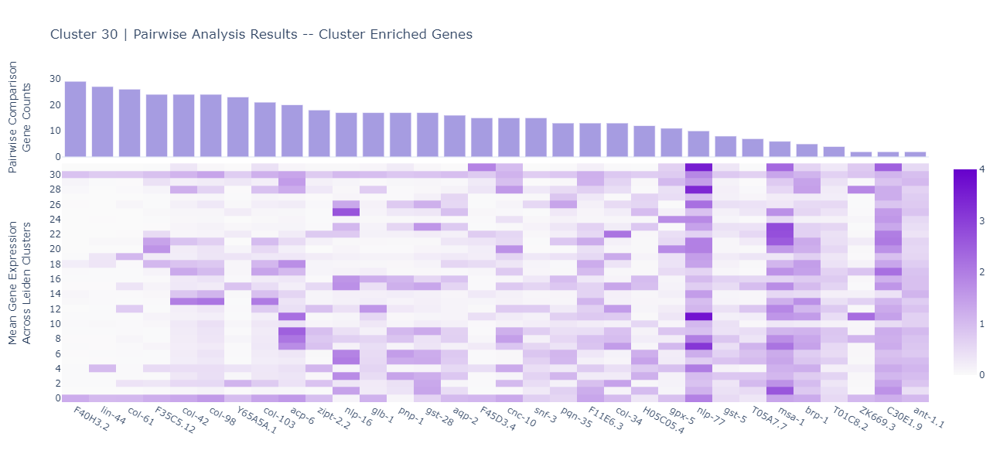

In [14]:
figure_utils.get_pairwise_results(adata_glia, cluster_id='30', filename='figures/pairwisefigure_S6E_Cluster30')

# SFig 6F -- <i>F40H3.2 & F35C5.12</i> Expression

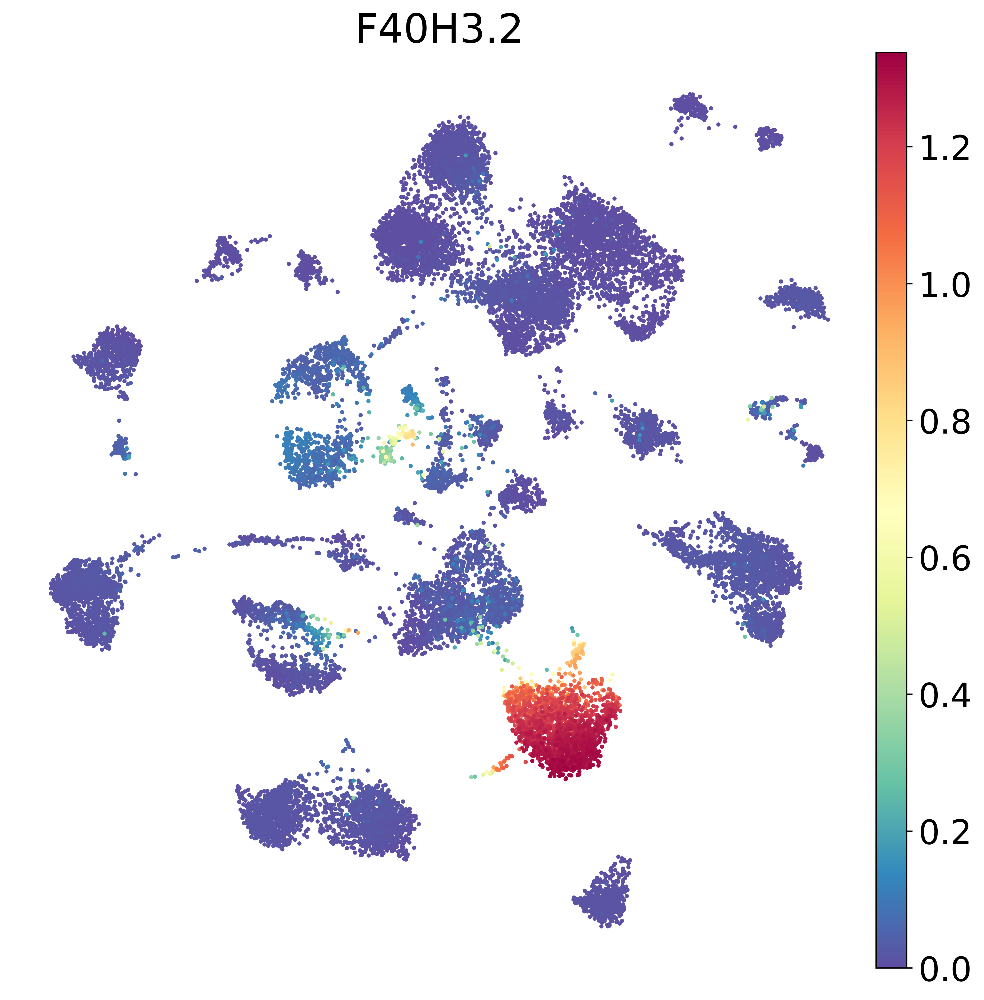

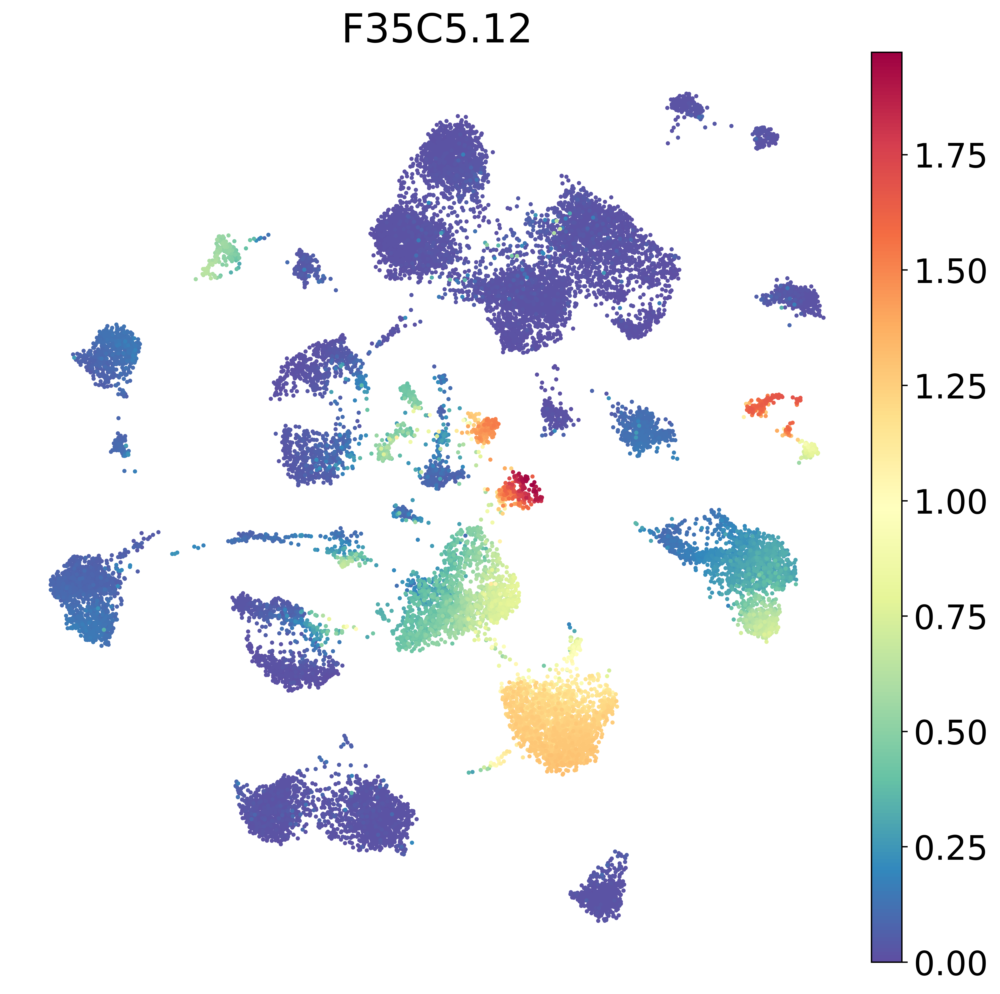

In [15]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['F40H3.2','F35C5.12'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S6F_{gene}.png',
            layer='magic_imputed_postBC',
        )

# SFig 6G -- AM/PHsh subclusters are identified by <i>vap-1 +ve or vap-1 -ve</i> markers

In [16]:
# color cluster 10 by the following: sexes vap-1 expression, vap-1 (+ve), vap-1 (-ve)
adata_amph = adata_glia[adata_glia.obs['Celltype'] == 'AMsh/PHsh',:].copy()

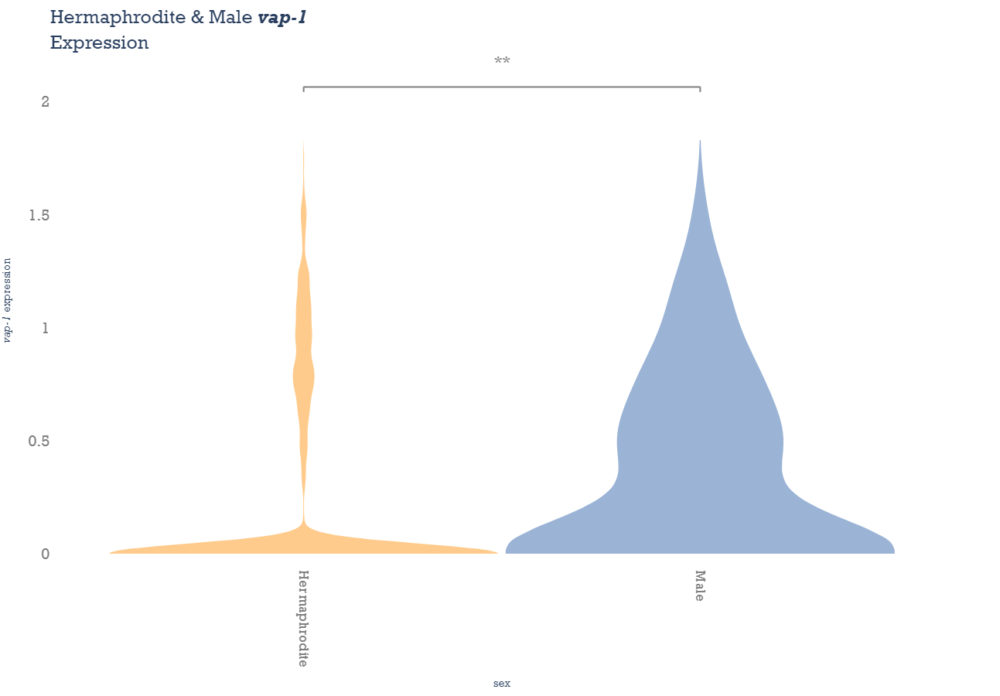

In [17]:
# male vs herm vap-1 expression
# custom_format = {'interline': 0.07, 'text_height': 1.07, 'color': 'gray', 'line_placement': 0.2}
figure_utils.sexes_gene_expression_comparison(ad_data=adata_amph, gene_name='vap-1', herm_color=HERM_COLOR,
                                              male_color=MALE_COLOR, filename='figures/ttest_expr_S6G_vap-1_cluster10')

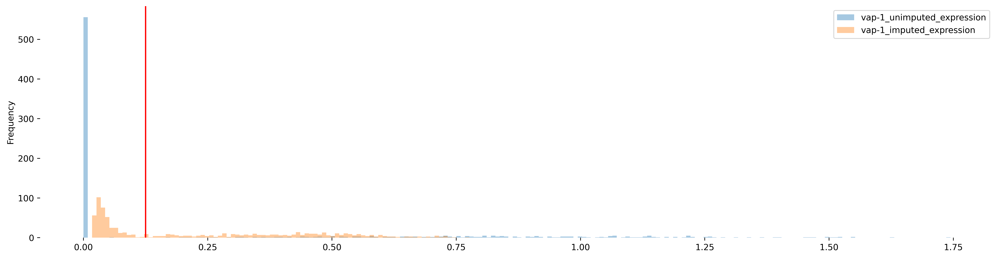

In [18]:
# visualize the distribution of expression in vap 1 and set a cut off (imputed and unimputed gene expression)
vap_1_clust10 = pd.DataFrame(adata_amph[:,'vap-1'].X.toarray(), columns=['vap-1_unimputed_expression'], index=adata_amph.obs_names)
vap_1_clust10.loc[:,'vap-1_imputed_expression'] = adata_amph[:,'vap-1'].layers['magic_imputed_postBC'].copy()
vap_1_clust10.plot(kind='hist', bins=200, figsize=(20,5), alpha=0.4)

# draw a cutoff for cells to be selected as vap-1 negative (the phasmid sheath)
threshold=0.125
plt.axvline(x=threshold, c='red')
plt.show()

In [19]:
# vap-1 (+ve) & (-ve) cut off -- using imputed gene exp
vap_cutoffs = vap_1_clust10.index[vap_1_clust10['vap-1_imputed_expression'] < threshold] # False=Phasmid, True=Amphis

# add annotations to metadata
adata_amph.obs.loc[:,'vap_labels'] = adata_amph.obs_names.map(lambda x: 'vap-1 (-ve)' if x in vap_cutoffs else 'vap-1 (+ve)')

# set colors for these new categories
vap_positive, vap_negative = 'red', 'blue'
adata_amph.uns['vap_labels_colors'] = [vap_positive, vap_negative]

In [20]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size':20.0}):
    sc.pl.umap(
        adata_amph,
        color=['leiden_postBC','sex','vap-1','vap_labels'],
        frameon=False,
        size=DOT_SIZE + 500,
        layer='magic_imputed_postBC',
        save='figure_S6G_vap-1_cluster10_thresholding_results.png'
        legend_loc=None
    )

SyntaxError: invalid syntax (2389655960.py, line 9)

# SFig 6H -- <i>Y57E12AL.4</i> Expression

In [ ]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['Y57E12AL.4'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S6H_{gene}.png',
            layer='magic_imputed_postBC',
        )

# SFig 6I -- Pairwise Cluster 27

In [ ]:
figure_utils.get_pairwise_results(adata_glia, cluster_id='27', filename='figures/pairwisefigure_S6I_Cluster27')

# SFig 6K -- <i>tra-2</i> Expression in Hermaphrodites and Males

In [ ]:
adata_OLso9 = adata_glia[adata_glia.obs['leiden_postBC'] == '9',:].copy()

In [ ]:
# custom_format = {'interline': 0.07, 'text_height': 1.07, 'color': 'gray', 'line_placement': 0.2}
figure_utils.sexes_gene_expression_comparison(ad_data=adata_OLso9, gene_name='tra-2', 
                                 herm_color=HERM_COLOR, male_color=MALE_COLOR, filename='figures/ttest_expr_S6K_tra-2_cluster9')

# SFig 6J -- <i>tra-2</i> Expression

In [ ]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['tra-2']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S6J_{gene}.png',
            layer='magic_imputed_postBC',
            vmin=0.0,
            vmax=0.5
        )

# SFig 6L -- <i>her-1, fem-1/2/3 & tra-1</i> Expression

In [ ]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['her-1','fem-1','fem-2','fem-3','tra-1'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S6L_{gene}.png',
            layer='magic_imputed_postBC',
            vmin=0.0,
            vmax=0.5
        )